In [87]:
import pandas as pd
df = pd.read_csv('./cat_acidentes.csv', sep = ';')

In [93]:
df['log2'] = df['log2'].fillna(df['log1'])
df['log1'] = df['log1'].fillna(df['log2'])
df['log2'] = df['log2'].fillna("Desconhecido")
df['log1'] = df['log1'].fillna("Desconhecido")
df['latitude'] = df['latitude'].fillna(df['latitude'].mean())
df['longitude'] = df['longitude'].fillna(df['longitude'].mean())
df['predial1'] = df['predial1'].fillna(df['predial1'].mean())
df['hora'] = df['hora'].fillna('Desconhecido')
df['consorcio'] = df['consorcio'].fillna('Desconhecido')
df['regiao'] = df['regiao'].fillna('Desconhecido')
df.isna().sum()

data_extracao    0
predial1         0
queda_arr        0
data             0
feridos          0
feridos_gr       0
mortes           0
morte_post       0
fatais           0
auto             0
taxi             0
lotacao          0
onibus_urb       0
onibus_met       0
onibus_int       0
caminhao         0
moto             0
carroca          0
bicicleta        0
outro            0
cont_vit         0
ups              0
patinete         0
idacidente       0
longitude        0
latitude         0
log1             0
log2             0
tipo_acid        0
dia_sem          0
hora             0
noite_dia        0
regiao           0
consorcio        0
dtype: int64

In [95]:
df

,data_extracao,predial1,queda_arr,data,feridos,feridos_gr,mortes,morte_post,fatais,auto,...,longitude,latitude,log1,log2,tipo_acid,dia_sem,hora,noite_dia,regiao,consorcio
0,2024-07-02 17:55:28,0.000000,0.0,2020-10-17 00:00:00,1,0,0,0,0,3,...,0.000000e+00,0.000000e+00,R MARCOS MOREIRA,R GASTON ENGLERT,ABALROAMENTO,SÁBADO,19:00:00.0000000,NOITE,NORTE,Desconhecido
1,2024-07-02 17:55:28,6699.000000,0.0,2019-01-01 00:00:00,1,0,0,0,0,3,...,-8.178406e+08,1.295680e+09,AV ASSIS BRASIL,AV ASSIS BRASIL,ABALROAMENTO,TERÇA-FEIRA,02:45:00.0000000,NOITE,NORTE,Desconhecido
2,2024-07-02 17:55:28,411.000000,0.0,2019-01-01 00:00:00,1,0,0,0,0,2,...,-8.267608e+08,1.292030e+09,R DR BARROS CASSAL,R DR BARROS CASSAL,ABALROAMENTO,TERÇA-FEIRA,07:36:00.0000000,DIA,CENTRO,Desconhecido
3,2024-07-02 17:55:28,1500.000000,0.0,2019-01-01 00:00:00,4,2,0,0,0,1,...,-8.272275e+08,1.285404e+09,AV FABIO ARAUJO SANTOS,AV FABIO ARAUJO SANTOS,CHOQUE,TERÇA-FEIRA,16:50:00.0000000,DIA,SUL,Desconhecido
4,2024-07-02 17:55:28,8799.000000,0.0,2019-01-01 00:00:00,5,0,0,0,0,3,...,-8.201465e+08,1.288712e+09,AV IPIRANGA,AV IPIRANGA,COLISÃO,TERÇA-FEIRA,19:00:00.0000000,NOITE,LESTE,Desconhecido
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
70577,2024-07-02 17:55:28,1655.531674,0.0,2024-06-29 00:00:00,1,0,0,0,0,0,...,-5.112897e+01,-2.999380e+01,AV FRANCISCO SILVEIRA BITENCOURT,AV FRANCISCO SILVEIRA BITENCOURT,ATROPELAMENTO,SÁBADO,17:00:00.0000000,DIA,NORTE,Desconhecido
70578,2024-07-02 17:55:28,444.000000,0.0,2024-06-29 00:00:00,2,0,0,0,0,2,...,-5.116973e+01,-3.003688e+01,R LUIZ VOELCKER,R LUIZ VOELCKER,ABALROAMENTO,SÁBADO,17:00:00.0000000,DIA,LESTE,Desconhecido
70579,2024-07-02 17:55:28,1929.000000,0.0,2024-06-29 00:00:00,1,0,0,0,0,1,...,-5.112518e+01,-3.001237e+01,AV BALTAZAR DE OLIVEIRA GARCIA,AV BALTAZAR DE OLIVEIRA GARCIA,ABALROAMENTO,SÁBADO,20:50:00.0000000,NOITE,NORTE,Desconhecido
70580,2024-07-02 17:55:28,570.000000,0.0,2024-06-29 00:00:00,1,0,0,0,0,1,...,-5.110156e+01,-3.002048e+01,AV ADELINO FERREIRA JARDIM,AV ADELINO FERREIRA JARDIM,ABALROAMENTO,SÁBADO,21:10:00.0000000,NOITE,NORTE,Desconhecido


In [97]:
import folium
from folium.plugins import HeatMap

#Região de porto alegre
mapa = folium.Map(location=[-30.1, -51.15], zoom_start=11)

coordenadas = list(zip(df.latitude, df.longitude))
mapa_calor = HeatMap(coordenadas, radius = 9, blur=10)
mapa.add_child(mapa_calor)

mapa

In [101]:
import folium
from folium.plugins import MarkerCluster

mapa = folium.Map(location=[-30.1, -51.15], zoom_start=11)
mapa_calor = MarkerCluster(coordenadas)
mapa.add_child(mapa_calor)

mapa

In [127]:
df['data'] = pd.to_datetime(df['data'], errors='coerce')
df_ano = df['data'].dt.year.value_counts()
df_ano = df_ano.drop(2202)
df_ano

data
2023    15508
2022    13920
2019    13229
2021    12397
2020     9294
2024     6233
Name: count, dtype: int64

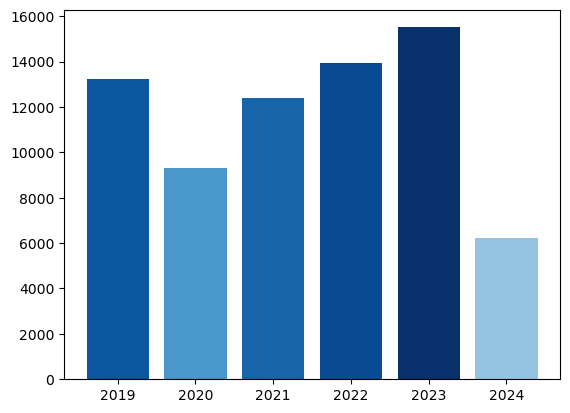

In [138]:
import matplotlib.pyplot as plt

gradient = df_ano/df_ano.max()
colors = plt.cm.Blues(gradient)

plt.bar(df_ano.index, df_ano.values, color = colors)
plt.show()